In [1]:
import pandas as pd
import numpy as np
import glob
import gzip

# Some Directories Creation and Dataset Creation

In [2]:
cd /kaggle/input/constellation-diagram-samples/

/kaggle/input/constellation-diagram-samples


In [3]:
for i in glob.glob('./Project/project/*'):
    print(i.split('/')[-1])


16q
4p
MLCW_project.ipynb
8p
8q
64q


In [4]:
cd /kaggle/working/

/kaggle/working


In [5]:
mkdir images


In [6]:
cd /kaggle/working/images

/kaggle/working/images


In [11]:
mkdir 64q

In [12]:
cd /kaggle/input/constellation-diagram-samples/Project/project/

/kaggle/input/constellation-diagram-samples/Project/project


In [13]:
for i in glob.glob('./*/*.csv'):
    print("{} {} db".format(i.split('_')[0].split('/')[-1],i.split('_')[1]))
    

64q 7 db
64q 1 db
64q 7 db
64q 6 db
64q 4 db
64q 5 db
64q 0 db
64q 3 db
64q 4 db
64q 8 db
64q 10 db
64q 6 db
64q 9 db
64q 8 db
64q 1 db
64q 9 db
64q 3 db
64q 0 db
64q 2 db
64q 2 db
64q 5 db
64q 10 db
4p 8 db
4p 1 db
4p 4 db
4p 3 db
4p 6 db
4p 6 db
4p 5 db
4p 4 db
4p 3 db
4p 2 db
4p 0 db
4p 9 db
4p 10 db
4p 0 db
4p 9 db
4p 1 db
4p 7 db
4p 7 db
4p 8 db
4p 2 db
4p 10 db
4p 5 db
8p 5 db
8p 0 db
8p 3 db
8p 10 db
8p 7 db
8p 8 db
8p 0 db
8p 1 db
8p 6 db
8p 6 db
8p 7 db
8p 9 db
8p 9 db
8p 10 db
8p 3 db
8p 4 db
8p 5 db
8p 1 db
8p 4 db
8p 8 db
8q 8 db
8q 7 db
8q 2 db
8q 0 db
8q 1 db
8q 4 db
8q 9 db
8q 1 db
8q 7 db
8q 10 db
8q 3 db
8q 4 db
8q 9 db
8q 5 db
8q 2 db
8q 3 db
8q 0 db
8q 6 db
8q 5 db
8q 6 db
8q 8 db
8q 10 db
16q 4 db
16q 2 db
16q 6 db
16q 7 db
16q 3 db
16q 0 db
16q 1 db
16q 7 db
16q 9 db
16q 8 db
16q 10 db
16q 5 db
16q 2 db
16q 6 db
16q 10 db
16q 9 db
16q 3 db
16q 8 db
16q 5 db
16q 4 db
16q 1 db
16q 0 db


# Samples of the dataset

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


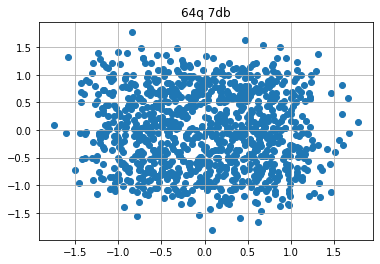

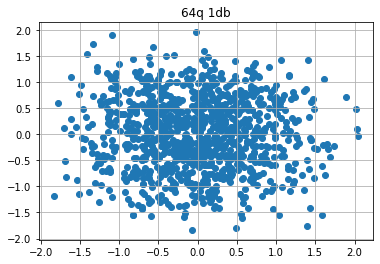

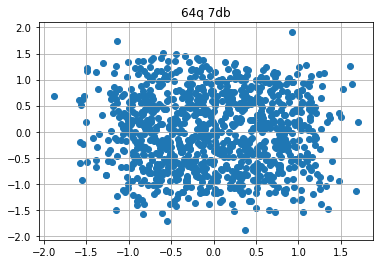

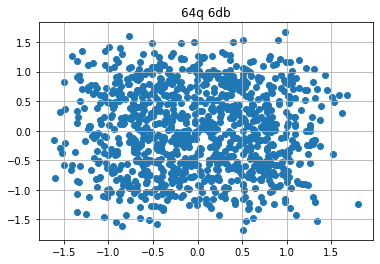

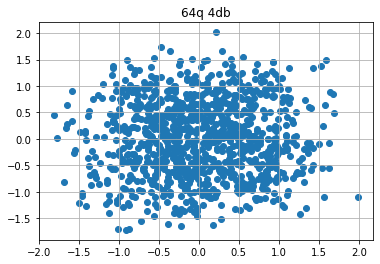

...

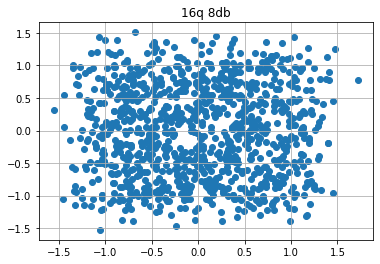

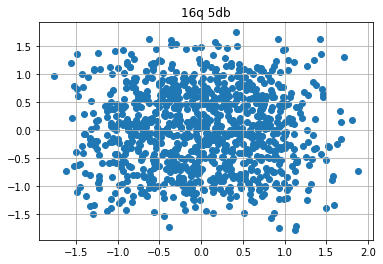

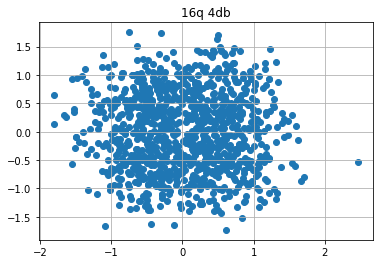

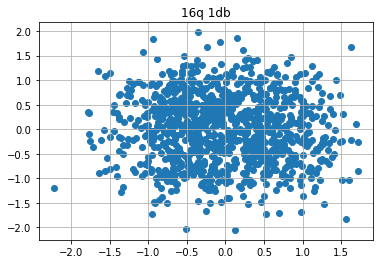

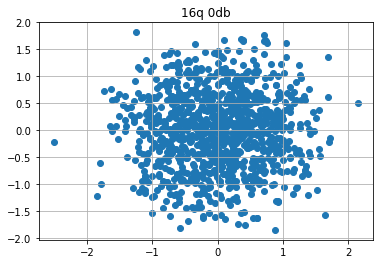

In [14]:
import matplotlib.pyplot as plt

lbl = []
count= 0
for i in glob.glob("./*/*csv"):
    df = pd.read_excel(i)
    lbl.append("{} {}db".format(i.split('_')[0].split('/')[-1],i.split('_')[1]))
    plt.figure()
    plt.scatter(df['Untitled'],df['Untitled 1'])
    plt.title("{} {}db".format(i.split('_')[0].split('/')[-1],i.split('_')[1]))
    plt.grid('off')
    plt.savefig("/kaggle/working/images/{}/{}.jpg".format("{}".format(i.split('_')[0].split('/')[-1],i.split('_')[1]),count))
    count+=1

In [15]:
cd /kaggle/working/images

/kaggle/working/images


# Creating Dataset

In [16]:
import cv2 
data = []
label = []
for i in glob.glob("./*/*.jpg"):
    label.append(i.split('/')[-2])
    data.append(cv2.resize(plt.imread(i),(224,224)))
#     data.append(cv2.resize(plt.imread(i)[:,:,0],(224,224)))

In [17]:
from sklearn.model_selection import train_test_split

X_train_r, X_test_r, y_train, y_test = train_test_split(np.asarray(data),np.asarray(label), test_size=0.15, random_state=42)
X_train_r.shape, X_test_r.shape, y_train.shape, y_test.shape

((91, 224, 224, 3), (17, 224, 224, 3), (91,), (17,))

# GradCAM Plus Plus Visualisation

In [18]:
import numpy as np
import tensorflow as tf
import random as rn
import os
import json

from keras import metrics, regularizers, optimizers, backend
from keras.callbacks import TensorBoard, EarlyStopping
from keras.models import Model
from keras.layers import Input, Dense, Dropout, BatchNormalization, Conv2D, Flatten, pooling
from keras.utils import np_utils, vis_utils

import scipy.io as sio

Using TensorFlow backend.


In [19]:
X_train = np.expand_dims(X_train_r[:,:,:,0], axis = -1)
X_test = np.expand_dims(X_test_r[:,:,:0], axis = -1)

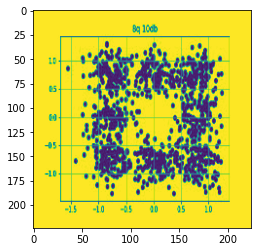

In [20]:
plt.imshow(X_train[:,:,:,0][12])

## Complete Dataset

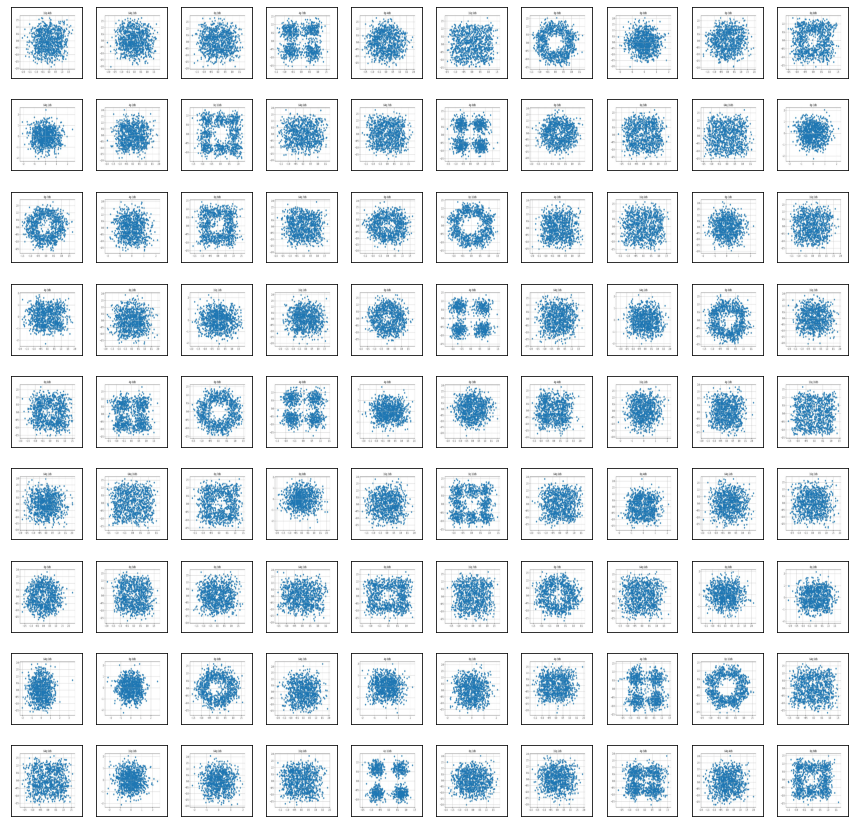

In [21]:
fig = plt.figure(figsize=(15,15))
# for j in range(len(X_train_r)):
for i in range(1, 9*10 +1):
    img = X_train_r[i-1]
    fig.add_subplot(9, 10, i)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(img)
plt.show()

In [22]:
nClass = 5
from keras.layers.convolutional import MaxPooling2D

_in_ = Input(shape = (X_train.shape[1], X_train.shape[2], 1))
ot = Conv2D(filters=64, kernel_size=(2,4), strides=1, padding='valid', use_bias=True, activation='relu')(_in_)
ot = MaxPooling2D(pool_size=(3, 3))(ot)
ot = Conv2D(filters=16, kernel_size=(1,4), strides=1, padding='valid', use_bias=True, activation='relu')(ot)
ot = MaxPooling2D(pool_size=(3, 3))(ot)
ot = Flatten()(ot)
ot = Dense(64, use_bias=True, activation='relu')(ot)
ot = Dense(20, use_bias=True, activation='relu')(ot)
_out_ = Dense(nClass, activation='softmax')(ot)
model = Model(_in_, _out_)

In [23]:
model.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 224, 224, 1)       0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 223, 221, 64)      576       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 74, 73, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 74, 70, 16)        4112      
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 24, 23, 16)        0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 8832)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 64)                5653

In [24]:
pip install imutils

  Created wheel for imutils: filename=imutils-0.5.3-py3-none-any.whl size=25850 sha256=7558d9192b5b831c367ba8030c62c99afd056b5a29051060f3ed76edeb32b5e8
  Stored in directory: /root/.cache/pip/wheels/fc/9c/6d/1826267c72afa51b564c9c6e0f66abc806879338bc593a2270
Successfully built imutils
You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


In [25]:
from keras.preprocessing.image import ImageDataGenerator
from keras.layers.pooling import AveragePooling2D
from keras.layers.core import Dropout
from keras.layers.core import Flatten
from keras.layers.core import Dense
from keras.models import Model
from keras.optimizers import Adam
from keras.utils import np_utils
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from imutils import paths
import cv2
import os
import numpy as np
import keras
import seaborn as sns
from matplotlib import pyplot as plt
from scipy.io import loadmat
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelBinarizer
from sklearn.metrics import confusion_matrix
from keras.preprocessing.image import ImageDataGenerator
# from pyimagesearch.gradcam import GradCAM
%matplotlib inline

In [26]:
from sklearn.preprocessing import LabelBinarizer
lb = LabelBinarizer()
y_t = lb.fit_transform(y_train)

## Model Training

In [27]:
optimizer = optimizers.Adam(lr=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-08)
model.compile(optimizer=optimizer,
              loss='categorical_crossentropy',
              metrics=['accuracy'])
early_stopping = EarlyStopping(monitor='val_loss', patience=10)
history = model.fit(X_train,
          y_t, 
          epochs=12, 
          batch_size=32,
          validation_split=0.1,
          shuffle=True,
          )

Train on 81 samples, validate on 10 samples
Epoch 1/12
81/81 [==============================] - 3s 37ms/step - loss: 53.3586 - accuracy: 0.1605 - val_loss: 39.1337 - val_accuracy: 0.0000e+00
Epoch 2/12
81/81 [==============================] - 2s 26ms/step - loss: 17.4033 - accuracy: 0.1235 - val_loss: 6.6941 - val_accuracy: 0.0000e+00
Epoch 3/12
81/81 [==============================] - 2s 25ms/step - loss: 3.2833 - accuracy: 0.2222 - val_loss: 1.8703 - val_accuracy: 0.3000
Epoch 4/12
81/81 [==============================] - 2s 25ms/step - loss: 1.5638 - accuracy: 0.2593 - val_loss: 1.5679 - val_accuracy: 0.4000
Epoch 5/12
81/81 [==============================] - 2s 25ms/step - loss: 1.5213 - accuracy: 0.3951 - val_loss: 1.4918 - val_accuracy: 0.4000
Epoch 6/12
81/81 [==============================] - 2s 25ms/step - loss: 1.4434 - accuracy: 0.4938 - val_loss: 1.5242 - val_accuracy: 0.4000
Epoch 7/12
81/81 [==============================] - 2s 27ms/step - loss: 1.1639 - accuracy: 0.7531 

In [28]:
train_acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

In [29]:
train_loss = history.history['loss']
val_loss = history.history['val_loss']

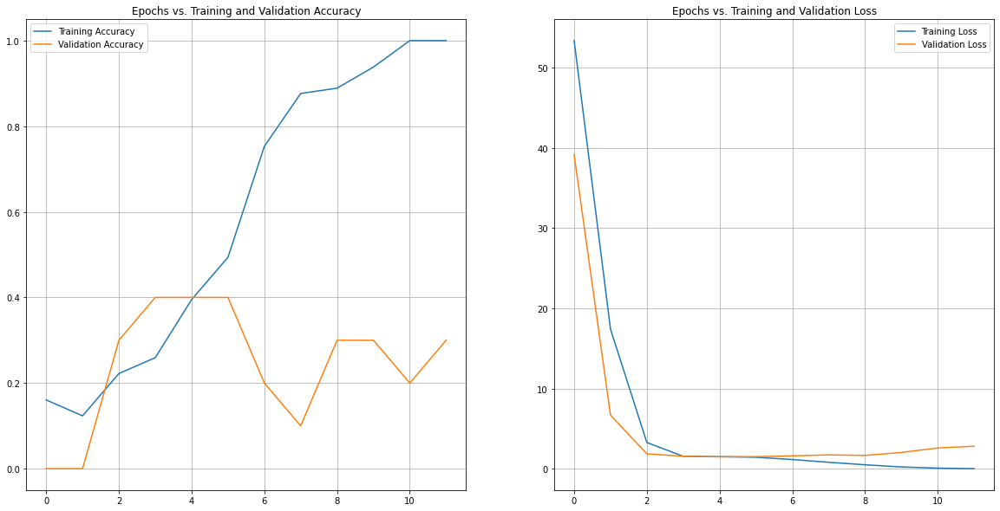

In [30]:
plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
plt.plot(train_acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.grid('ON')
plt.legend()

plt.title('Epochs vs. Training and Validation Accuracy'
         )
    
plt.subplot(1, 2, 2)
plt.plot(train_loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.grid('ON')
plt.legend()
plt.title('Epochs vs. Training and Validation Loss')

plt.show()

In [31]:
y_pred = model.predict(X_train)
y_p = lb.inverse_transform(y_pred)
y_t = lb.inverse_transform(y_t)
# y_t = lb.inverse_transform(y_t) 
# y_p = lb.fit_transform(y_pred)
# y_t = lb.inverse_transform(y_t)
# y_p,y_t
y_t,y_p

(array(['16q', '64q', '8q', '4p', '8p', '16q', '8p', '8p', '8p', '8q',
        '64q', '4p', '8q', '64q', '64q', '4p', '8p', '8q', '64q', '8p',
        '8p', '4p', '8q', '64q', '8p', '8p', '4p', '16q', '8p', '16q',
        '4p', '8q', '16q', '16q', '8p', '4p', '64q', '64q', '8p', '16q',
        '8q', '4p', '8p', '4p', '4p', '8p', '4p', '16q', '4p', '16q',
        '64q', '64q', '8q', '8q', '16q', '8q', '64q', '8q', '64q', '16q',
        '8p', '8q', '8q', '64q', '8q', '16q', '8p', '64q', '8q', '8q',
        '64q', '8p', '8p', '64q', '4p', '8q', '4p', '4p', '8p', '64q',
        '64q', '16q', '64q', '16q', '4p', '8q', '16q', '4p', '64q', '8q',
        '64q'], dtype='<U3'),
 array(['16q', '64q', '8q', '4p', '8p', '16q', '8p', '8p', '8p', '8q',
        '64q', '4p', '8q', '64q', '64q', '4p', '8p', '8q', '64q', '8p',
        '8p', '4p', '8q', '64q', '8p', '8p', '4p', '16q', '8p', '16q',
        '4p', '8q', '16q', '16q', '8p', '4p', '64q', '64q', '8p', '16q',
        '8q', '4p', '8p', '4p', '4p'

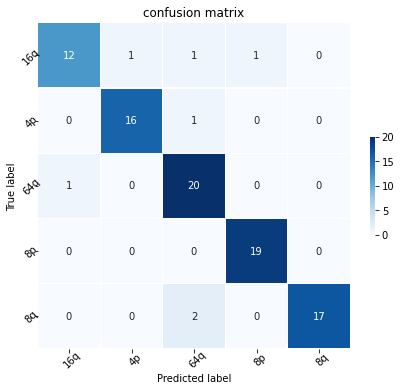

In [32]:
import copy
# x = preprocess_input(copy.deepcopy(x_test))
# y_preds = model.predict(x)
# y_preds = np.argmax(y_pred, axis=1)
# y_trues = np.argmax(y_test, axis=1)
cm = confusion_matrix(y_t, y_p)

fig, ax = plt.subplots(figsize=(7, 6))

sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar_kws={'shrink': .3}, linewidths=.1, ax=ax)

ax.set(
    xticklabels=np.unique(y_train),
    yticklabels=np.unique(y_train),
    title='confusion matrix',
    ylabel='True label',
    xlabel='Predicted label'
)
params = dict(rotation=45, ha='center', rotation_mode='anchor')
plt.setp(ax.get_yticklabels(), **params)
plt.setp(ax.get_xticklabels(), **params)
plt.show()

In [33]:
y = lb.fit_transform(y_train)
test_loss, test_acc = model.evaluate(x=X_train, y=y, verbose=0)

print('Test accuracy is: {:0.4f} % \nTest loss is: {:0.4f} %'.format(test_acc*100, test_loss*100))

Test accuracy is: 92.3077 % 
Test loss is: 32.3134 %


In [34]:
cd /kaggle/input/gradcam-pyimagesearch/keras-grad-cam

/kaggle/input/gradcam-pyimagesearch/keras-grad-cam


In [35]:
y_t.shape, y_p.shape

((91,), (91,))

In [36]:
classes = np.unique(y_train)
print(classes)
v = []
for j in classes:
    for i in range(len(y_t)):
            if y_p[i] == y_t[i] == j:
                v.append(j)
                v.append(i)
        
    
    
location = np.array(v).reshape((-1,2))
pd.DataFrame(location)

['16q' '4p' '64q' '8p' '8q']


,0,1
0,16q,0
1,16q,5
2,16q,27
3,16q,29
4,16q,32
...,...,...
79,8q,62
80,8q,64
81,8q,68
82,8q,69


In [37]:
# import gradcam
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications import VGG16
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.applications import imagenet_utils
import numpy as np
import argparse
import imutils
import cv2

In [38]:
for (i,j) in enumerate(model.layers):
    print(i,j)

0 <keras.engine.input_layer.InputLayer object at 0x7fe513d2a590>
1 <keras.layers.convolutional.Conv2D object at 0x7fe51aaf88d0>
2 <keras.layers.pooling.MaxPooling2D object at 0x7fe5392c1250>
3 <keras.layers.convolutional.Conv2D object at 0x7fe513d0ff10>
4 <keras.layers.pooling.MaxPooling2D object at 0x7fe513d2a790>
5 <keras.layers.core.Flatten object at 0x7fe513c49d90>
6 <keras.layers.core.Dense object at 0x7fe513ccdfd0>
7 <keras.layers.core.Dense object at 0x7fe513c90950>
8 <keras.layers.core.Dense object at 0x7fe513c76d50>


In [39]:
layer_name = []
for i in model.layers:
    
    layer_name.append(i.name)

In [40]:
def grad_cam_plus_plus(model, x, layer_name):
    """Grad-CAM++ function"""
    
    cls = np.argmax(model.predict(x))
    y_c = model.output[0, cls]
    conv_output = model.get_layer(layer_name).output
    grads = K.gradients(y_c, conv_output)[0]

    first = K.exp(y_c) * grads
    second = K.exp(y_c) * grads * grads
    third = K.exp(y_c) * grads * grads * grads

    gradient_function = K.function([model.input], [y_c, first, second, third, conv_output, grads])
    y_c, conv_first_grad, conv_second_grad, conv_third_grad, conv_output, grads_val = gradient_function([x])
    global_sum = np.sum(conv_output[0].reshape((-1,conv_first_grad[0].shape[2])), axis=0)

    alpha_num = conv_second_grad[0]
    alpha_denom = conv_second_grad[0] * 2.0 + conv_third_grad[0] * global_sum.reshape((1, 1, conv_first_grad[0].shape[2]))
    alpha_denom = np.where(alpha_denom != 0.0, alpha_denom, np.ones(alpha_denom.shape))
    alphas = alpha_num / alpha_denom # 0


    weights = np.maximum(conv_first_grad[0], 0.0)
    alpha_normalization_constant = np.sum(np.sum(alphas, axis=0), axis=0) # 0
    alphas /= alpha_normalization_constant.reshape((1, 1, conv_first_grad[0].shape[2])) # NAN
    deep_linearization_weights = np.sum((weights * alphas).reshape((-1, conv_first_grad[0].shape[2])), axis=0)

    cam = np.sum(deep_linearization_weights * conv_output[0], axis=2)
    cam = np.maximum(cam, 0) # Passing through ReLU
    cam /= np.max(cam)       # scale 0 to 1.0  

    return cls, cam

In [41]:
import copy
import warnings
warnings.filterwarnings('ignore')

import cv2
import keras
from keras import backend as K
from keras.models import Model, Sequential
from keras.layers import Dense, Dropout, BatchNormalization, Flatten, Input
from keras.layers import Conv2D, Activation, GlobalAveragePooling2D
from keras.preprocessing.image import ImageDataGenerator
from keras.preprocessing.image import load_img, img_to_array
from keras.applications.resnet50 import preprocess_input, ResNet50
import matplotlib
import matplotlib.pylab as plt
import numpy as np
import seaborn as sns
import shap
from sklearn.utils import shuffle
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split

In [42]:
def superimpose(img, cam):
    """superimpose original image and cam heatmap"""
    
    heatmap = cv2.resize(cam, (img.shape[2], img.shape[1]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

    superimposed_img = heatmap * 4 + img * .15
    superimposed_img = np.minimum(superimposed_img, 255.0).astype(np.uint8)  # scale 0 to 255  
    superimposed_img = cv2.cvtColor(superimposed_img.reshape((224,224,3)), cv2.COLOR_BGR2RGB)
    
    return img, heatmap, superimposed_img

In [43]:
final_gradcam_plus_plus = []
for g in range(len(location)):   
    image = X_train_r[int(location[g,1])]
    image = np.expand_dims(image, axis = 0)
    img = np.uint8(copy.deepcopy(image[:,:,:,0].reshape((1,224,224,1))))
    cls_pred_plus_plus, cam_plus_plus = grad_cam_plus_plus(model, img, layer_name[3])
    img_plus_plus, heatmap_plus_plus, superimposed_img_plus_plus = superimpose(img, cam_plus_plus)
    I = cv2.hconcat([image.reshape((224,224,3)), heatmap_plus_plus,superimposed_img_plus_plus])
    final_gradcam_plus_plus.append(I)
#     plt.imshow(superimposed_img_plus_plus), plt.imshow(heatmap_plus_plus)

In [44]:
v = {'16q':'16QPSK', '4p':'4PSK','64q':'64QAM', '8p':'8PSK','8q':'8QAM'}

In [45]:
mkdir /kaggle/working/result

## Correctly Classified

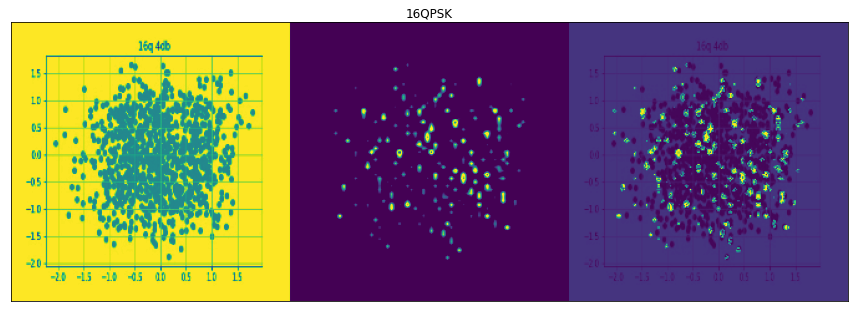

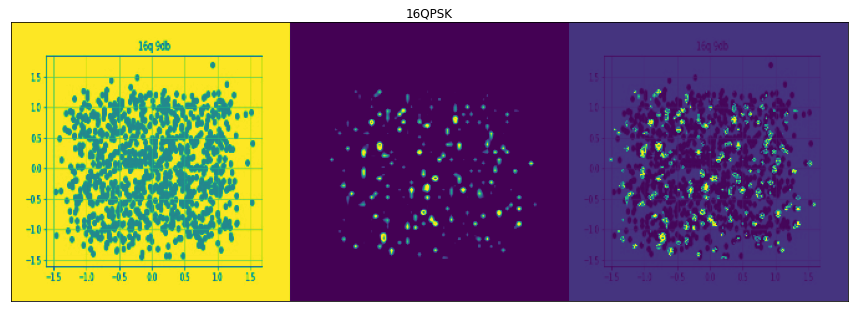

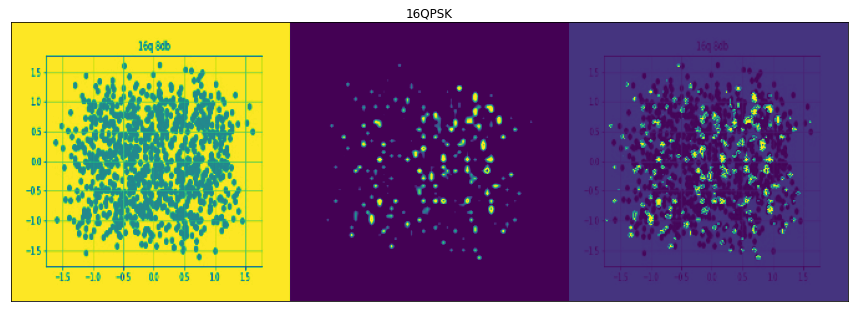

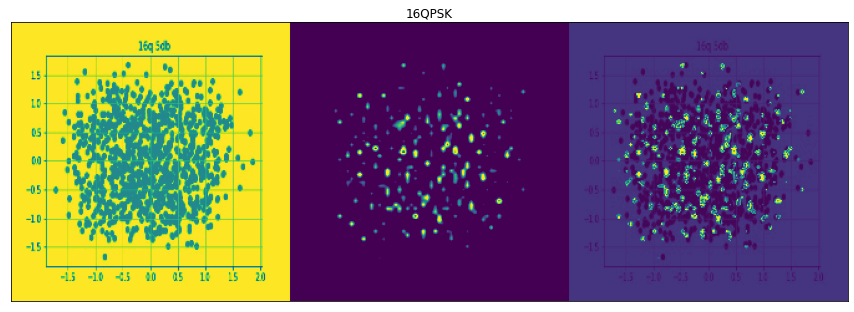

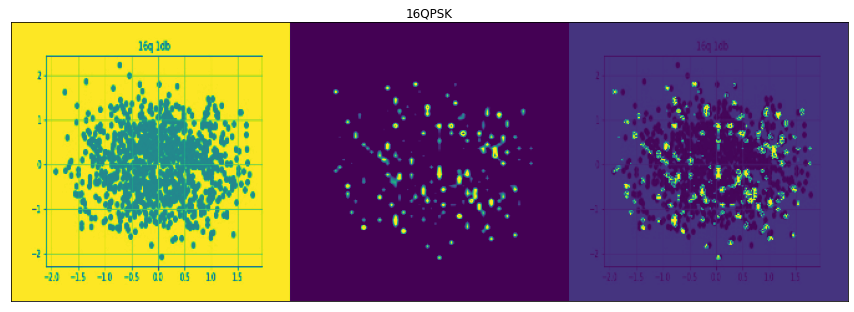

...

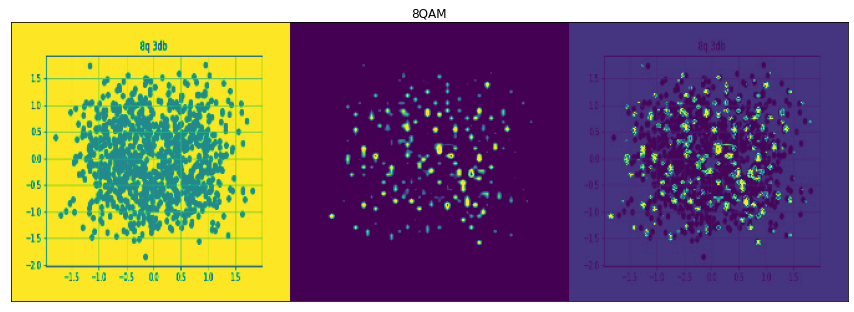

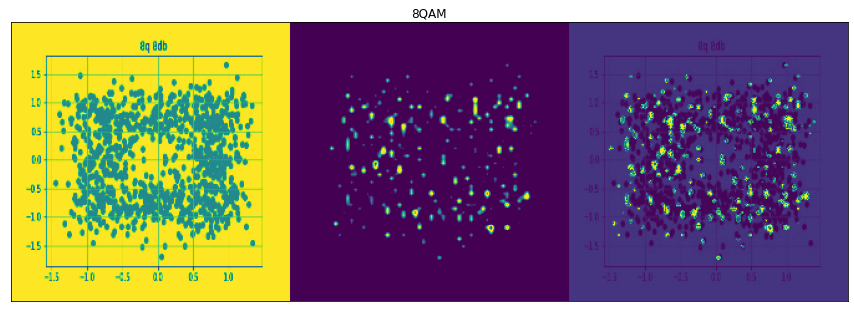

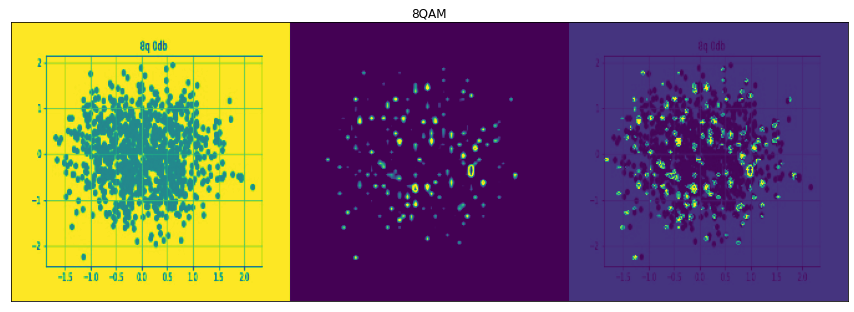

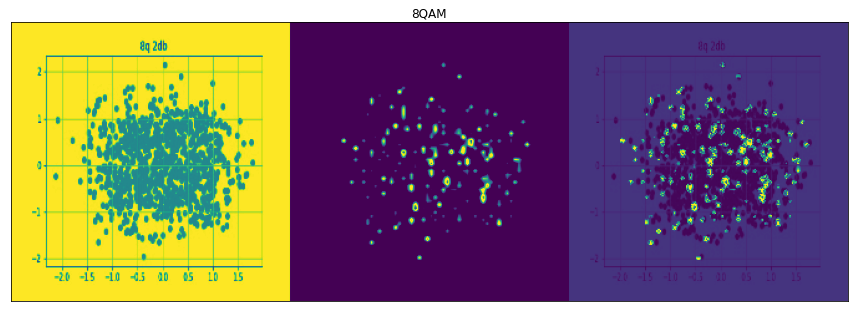

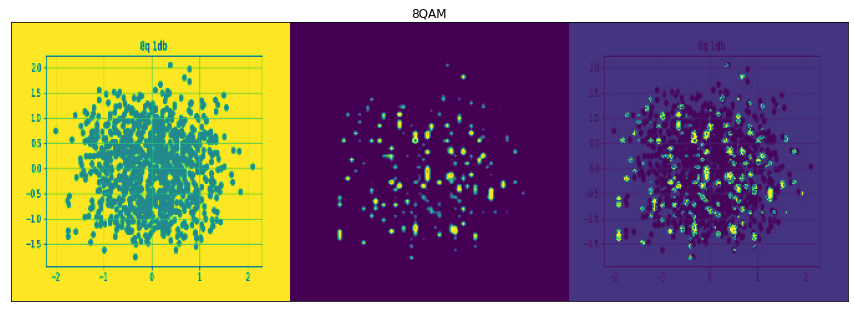

In [46]:
gpp_img = []
for i in range(len(final_gradcam_plus_plus)):
    plt.figure(figsize=(15, 15))
    plt.title(v[location[i,0]])
    plt.xticks([])
    plt.yticks([])
    plt.imshow(final_gradcam_plus_plus[i][:,:,1])
    plt.savefig("/kaggle/working/result/{}.jpg".format(i))
    plt.show()

In [47]:
mkdir /kaggle/working/result2

## Incorrectly Classified

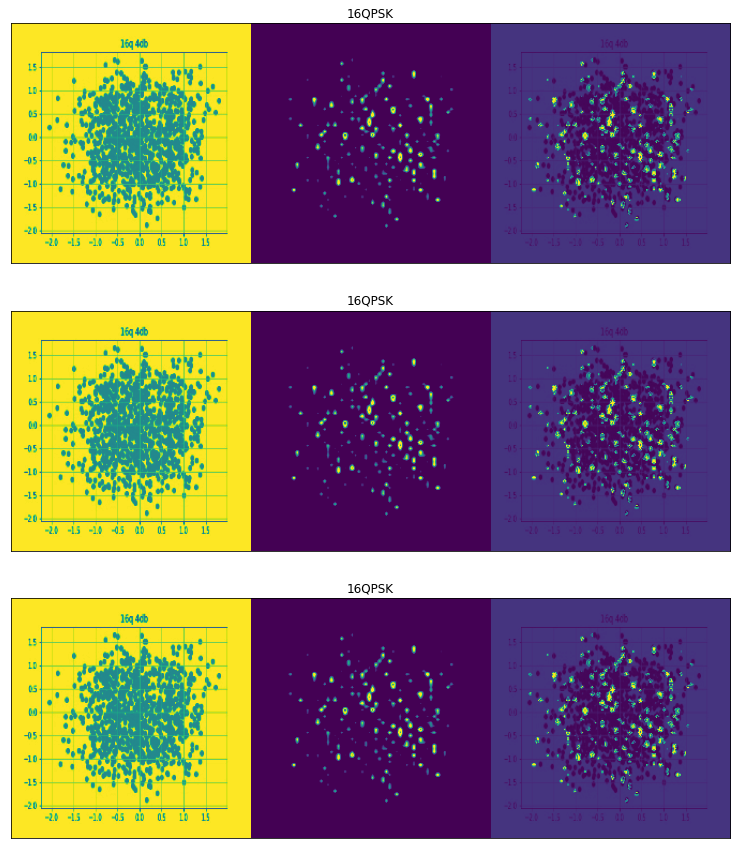

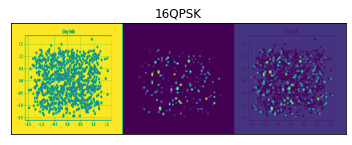

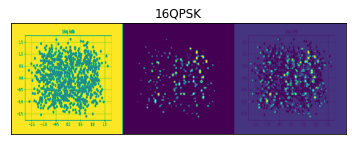

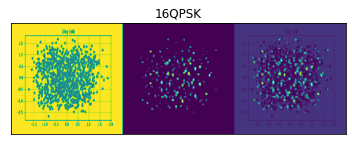

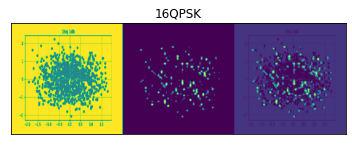

...

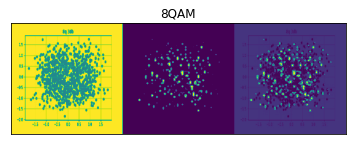

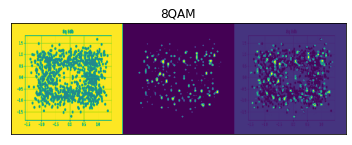

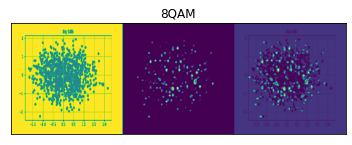

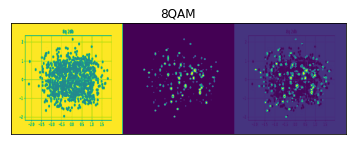

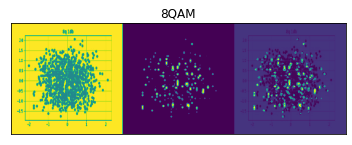

In [48]:
fig=plt.figure(figsize=(15, 15))
for j in range(len(final_gradcam_plus_plus)):
    for i in range(1, 3*1 +1):
        img = final_gradcam_plus_plus[j]
        fig.add_subplot(3, 1, i)
        plt.xticks([])
        plt.yticks([])
        plt.imshow(img[:,:,1])
        plt.title(v[location[j,0]])
    plt.savefig('/kaggle/working/result2/{}.jpg'.format(j))
    plt.show()

In [ ]:
rm -R /kaggle/working/cummulative_result.zip

In [55]:
location

array([['16q', '0'],
       ['16q', '5'],
       ['16q', '27'],
       ['16q', '29'],
       ['16q', '32'],
       ['16q', '33'],
       ['16q', '39'],
       ['16q', '47'],
       ['16q', '49'],
       ['16q', '54'],
       ['16q', '59'],
       ['16q', '65'],
       ['4p', '3'],
       ['4p', '11'],
       ['4p', '15'],
       ['4p', '21'],
       ['4p', '26'],
       ['4p', '30'],
       ['4p', '35'],
       ['4p', '41'],
       ['4p', '43'],
       ['4p', '44'],
       ['4p', '46'],
       ['4p', '48'],
       ['4p', '74'],
       ['4p', '76'],
       ['4p', '77'],
       ['4p', '84'],
       ['64q', '1'],
       ['64q', '10'],
       ['64q', '13'],
       ['64q', '14'],
       ['64q', '18'],
       ['64q', '23'],
       ['64q', '36'],
       ['64q', '37'],
       ['64q', '50'],
       ['64q', '51'],
       ['64q', '56'],
       ['64q', '58'],
       ['64q', '63'],
       ['64q', '67'],
       ['64q', '70'],
       ['64q', '73'],
       ['64q', '79'],
       ['64q', '80'],
       [

In [49]:
import zipfile

def zipdir(path, ziph):
    # ziph is zipfile handle
    for root, dirs, files in os.walk(path):
        for file in files:
            ziph.write(os.path.join(root, file))

if __name__ == '__main__':
    zipf = zipfile.ZipFile('/kaggle/working/result1.zip', 'w', zipfile.ZIP_DEFLATED)
    zipdir('/kaggle/working/result', zipf)
    zipf.close()

In [52]:
y = [int(img[:,int(img.shape[1]*2/3):].shape[0]/3),int(img[:,int(img.shape[1]*2/3):].shape[0]/3), 2*int(img[:,int(img.shape[1]*2/3):].shape[0]/3),2*int(img[:,int(img.shape[1]*2/3):].shape[0]/3)]
x = [int(img[:,int(img.shape[1]*2/3):].shape[0]/3),2*int(img[:,int(img.shape[1]*2/3):].shape[0]/3), int(img[:,int(img.shape[1]*2/3):].shape[0]/3) , 2*int(img[:,int(img.shape[1]*2/3):].shape[0]/3) ]

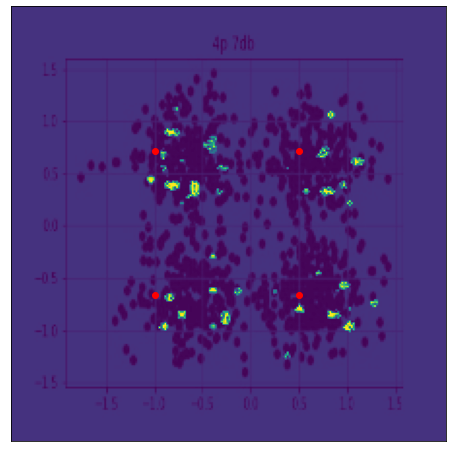

In [72]:
plt.figure(figsize = (8,8))
plt.xticks([])
plt.yticks([])
plt.scatter(x,y, marker ='o', color = 'r')
img = final_gradcam_plus_plus[26][:,:,1]
plt.imshow(img[:,int(img.shape[1]*2/3):])
plt.savefig('/kaggle/working/with_base_points.jpg')